In [1]:
import os,glob
import pandas as pd
import pygmt
import pickle
import warnings  
warnings.filterwarnings("ignore")

In [2]:
pygmt.config(FONT_ANNOT_PRIMARY = '10p,Times-Roman',
            FONT_LABEL = '14p,Times-Roman',
            MAP_LABEL_OFFSET = '4p',
            MAP_TICK_LENGTH_PRIMARY = '5p',
            PROJ_LENGTH_UNIT = 'c',
            MAP_ANNOT_OFFSET_PRIMARY = '5p',
            MAP_ANNOT_OFFSET_SECONDARY = '5p',
            MAP_FRAME_TYPE = 'fancy',
            MAP_FRAME_WIDTH = 'auto',
            FORMAT_GEO_MAP = 'D',
            PS_CHAR_ENCODING = 'Standard+',
            MAP_FRAME_PEN = '2p,black')


def PygmtBegin(figmap, region, title):
    figmap.basemap(region=region, projection="M15c", frame = ['x1f0.5', 'y1f0.5', f'nSeW+t"{title}"'])
    figmap.grdimage('@earth_relief_15s',region =region, cmap="eleva.cpt",monochrome=True, shading=True, transparency=70)
    grdpath = '/Volumes/home/Research/GMT/LithoThickness'
    figmap.grdimage(f'{grdpath}/area_masked.grd',region =region, cmap=f'{grdpath}/Lith.cpt', transparency=30)
    figmap.grdcontour(f'{grdpath}/area_masked.grd',limit=[50,150],interval='10+e10p',annotation=20)
    figmap.colorbar(cmap=f'{grdpath}/Lith.cpt',position='x9.8c/14.6c+w4c/0.3c+h+ml',frame=['a20f10', 'x+l"Lithosphre Thickness"', "y+lkm"]) 
    # figmap.grdimage('@earth_relief_15s',region =region, cmap="eleva.cpt",monochrome=True, shading=True, transparency=50)

    figmap.coast(resolution = 'h', shorelines ='1/thinnest,black', water='white', borders = '1/0.25p,--')
#     figmap.plot(data=smooth_fault,pen='1p,brown')
    Volcano = '/Volumes/home/Research/DataBase/01_Armenia/02_Volcano_list.csv'
    dv = pd.read_csv(Volcano)
    figmap.plot(x=dv['lon'],y=dv['lat'],style="kvolcano/0.4c", pen='0.1p,black', color="black")

def PiercePoint(evdep, stlat, stlon, evlat, evlon, phase, PierceDep):
        
    cmd = """
    taup pierce -mod iasp91 -h %(evdep)f -sta %(stlat)f %(stlon)f -evt %(evlat)f %(evlon)f -ph %(phase)s --pierce %(PierceDep)f -nodiscon  > temp.txt
    """ % locals()
    os.system(cmd)

    if evdep > PierceDep:
        cmd = """
        cat temp.txt | awk 'NR==2 {print$4, $5}'
        """ % locals()
        p = os.popen(cmd)
        text = str(p.read())
        p.close()
        p_lat=float(text.rsplit(' ')[0])
        p_lon=float(text.rsplit(' ')[1][:-1])
    elif evdep <= PierceDep:
        cmd = """
        cat temp.txt | awk 'NR==3 {print$4, $5}'
        """ % locals()
        p = os.popen(cmd)
        text = str(p.read())
        p.close()
        p_lat=float(text.rsplit(' ')[0])
        p_lon=float(text.rsplit(' ')[1][:-1])  
    
    return p_lon, p_lat

In [3]:
PKLpath = '/Volumes/home/Research/STEP/01_Split'
path    = '/Volumes/home/Research/STEP/02_Station_result_csv'
remove  = '/Volumes/home/Research/STEP/05_Station_result_statistics/V4_Remove_catalog.txt'
figpath = '/Volumes/home/Research/STEP/12_PiercePoint'
smooth_fault='/Volumes/home/Research/DataBase/01_Armenia/00_smooth_fault_7.txt'
Afault='/Volumes/home/Research/DataBase/01_Armenia/00_A_fault_20220624.txt'
method = 'SC'

In [5]:
dr = pd.read_csv(remove,sep='\s+',names=['station','time','phase','a','b','c','d','e','f','g'])

==================IU.GNI==================
GNI 20131123_074832
GNI 20200613_210830
GNI 20130514_003226
==================AM.ALAV==================
==================AM.ARZA==================
==================AM.BAUR==================
==================AM.BYUR==================
==================AM.GERK==================
==================AM.KECH==================
==================AM.LICH==================
==================AM.MAGY==================
==================AM.NAVR==================
==================AM.SHEN==================
==================AM.TSAP==================
==================AM.VAND==================
VAND 20200805_120536
VAND 20190731_150233
VAND 20160729_211826
VAND 20180211_231415
==================AM.ZARN==================
ZARN 20180211_231415
==================KO.BCA==================
==================KO.TASB==================
==================GO.AKH==================
==================GO.BGD==================
==================GO.CHVG==================
===

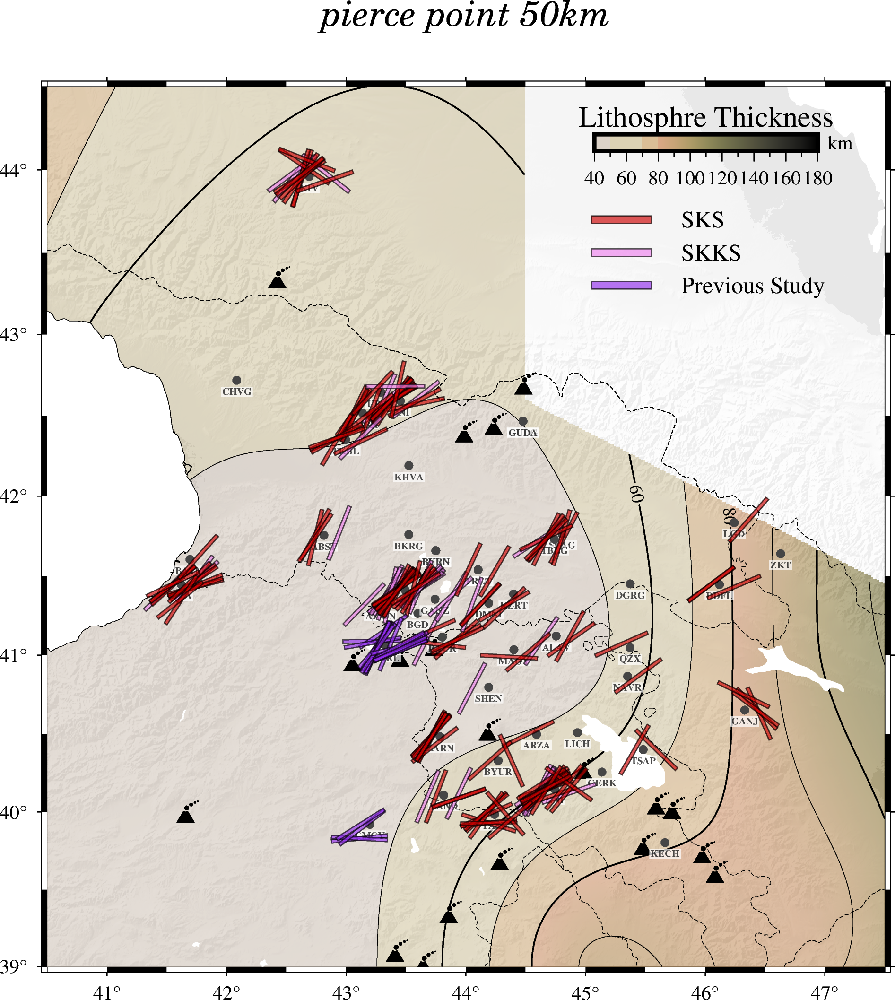

==================IU.GNI==================
GNI 20131123_074832
GNI 20200613_210830
GNI 20130514_003226
==================AM.ALAV==================
==================AM.ARZA==================
==================AM.BAUR==================
==================AM.BYUR==================
==================AM.GERK==================
==================AM.KECH==================
==================AM.LICH==================
==================AM.MAGY==================
==================AM.NAVR==================
==================AM.SHEN==================
==================AM.TSAP==================
==================AM.VAND==================
VAND 20200805_120536
VAND 20190731_150233
VAND 20160729_211826
VAND 20180211_231415
==================AM.ZARN==================
ZARN 20180211_231415
==================KO.BCA==================
==================KO.TASB==================
==================GO.AKH==================
==================GO.BGD==================
==================GO.CHVG==================
===

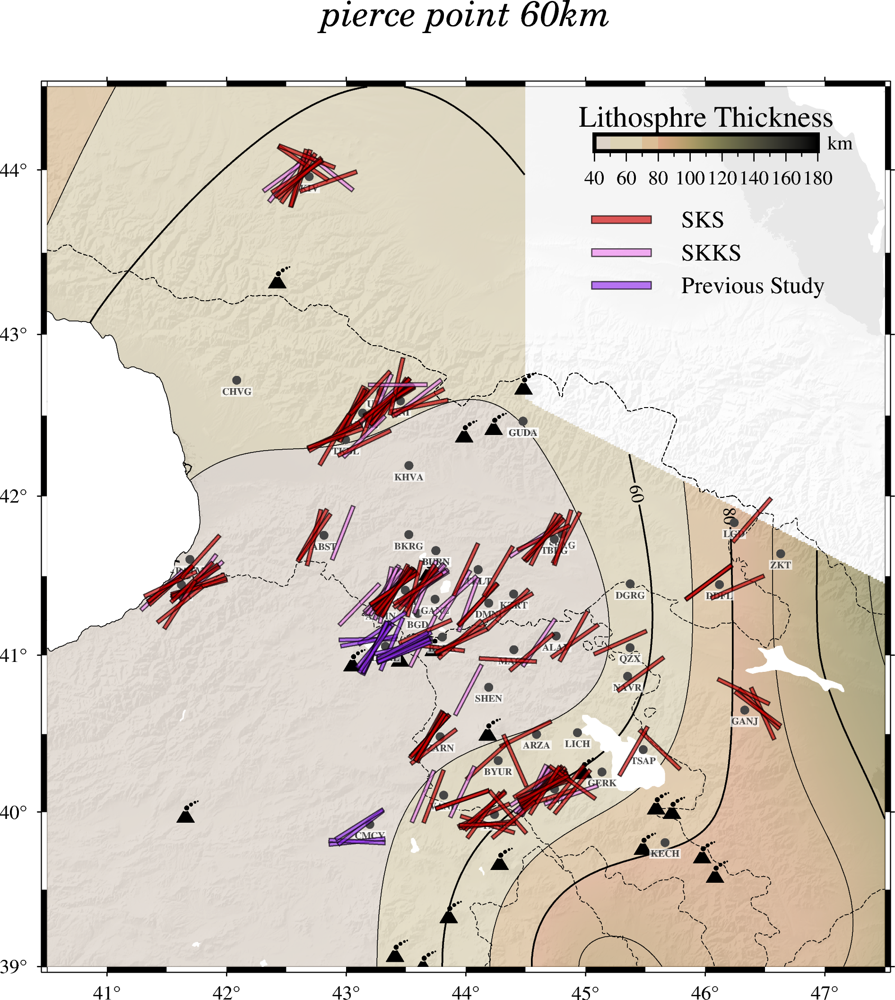

==================IU.GNI==================
GNI 20131123_074832
GNI 20200613_210830
GNI 20130514_003226
==================AM.ALAV==================
==================AM.ARZA==================
==================AM.BAUR==================
==================AM.BYUR==================
==================AM.GERK==================
==================AM.KECH==================
==================AM.LICH==================
==================AM.MAGY==================
==================AM.NAVR==================
==================AM.SHEN==================
==================AM.TSAP==================
==================AM.VAND==================
VAND 20200805_120536
VAND 20190731_150233
VAND 20160729_211826
VAND 20180211_231415
==================AM.ZARN==================
ZARN 20180211_231415
==================KO.BCA==================
==================KO.TASB==================
==================GO.AKH==================
==================GO.BGD==================
==================GO.CHVG==================
===

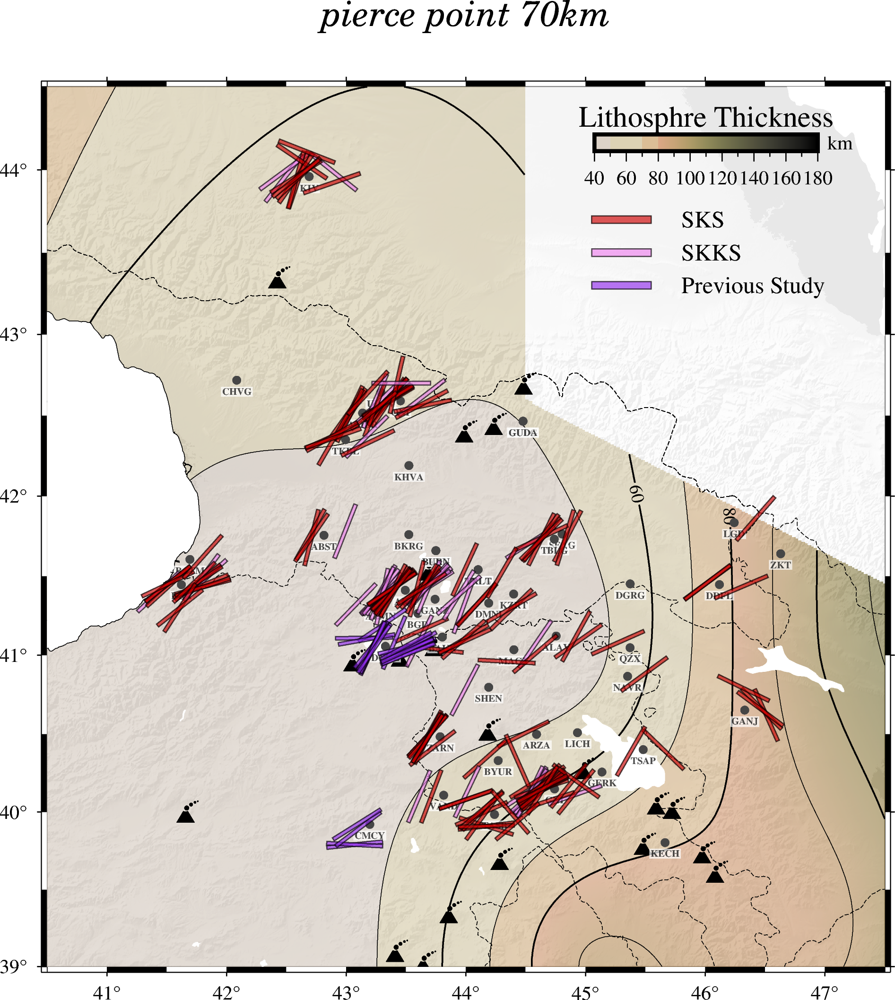

==================IU.GNI==================
GNI 20131123_074832
GNI 20200613_210830
GNI 20130514_003226
==================AM.ALAV==================
==================AM.ARZA==================
==================AM.BAUR==================
==================AM.BYUR==================
==================AM.GERK==================
==================AM.KECH==================
==================AM.LICH==================
==================AM.MAGY==================
==================AM.NAVR==================
==================AM.SHEN==================
==================AM.TSAP==================
==================AM.VAND==================
VAND 20200805_120536
VAND 20190731_150233
VAND 20160729_211826
VAND 20180211_231415
==================AM.ZARN==================
ZARN 20180211_231415
==================KO.BCA==================
==================KO.TASB==================
==================GO.AKH==================
==================GO.BGD==================
==================GO.CHVG==================
===

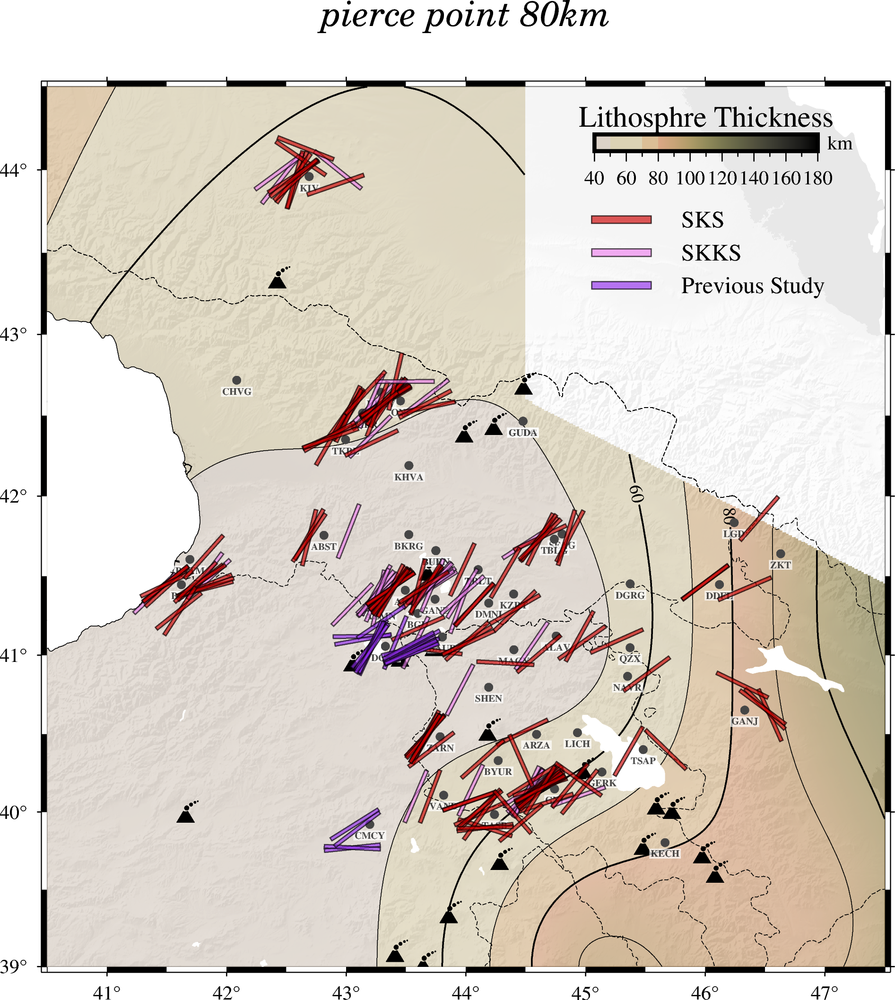

==================IU.GNI==================
GNI 20131123_074832
GNI 20200613_210830
GNI 20130514_003226
==================AM.ALAV==================
==================AM.ARZA==================
==================AM.BAUR==================
==================AM.BYUR==================
==================AM.GERK==================
==================AM.KECH==================
==================AM.LICH==================
==================AM.MAGY==================
==================AM.NAVR==================
==================AM.SHEN==================
==================AM.TSAP==================
==================AM.VAND==================
VAND 20200805_120536
VAND 20190731_150233
VAND 20160729_211826
VAND 20180211_231415
==================AM.ZARN==================
ZARN 20180211_231415
==================KO.BCA==================
==================KO.TASB==================
==================GO.AKH==================
==================GO.BGD==================
==================GO.CHVG==================
===

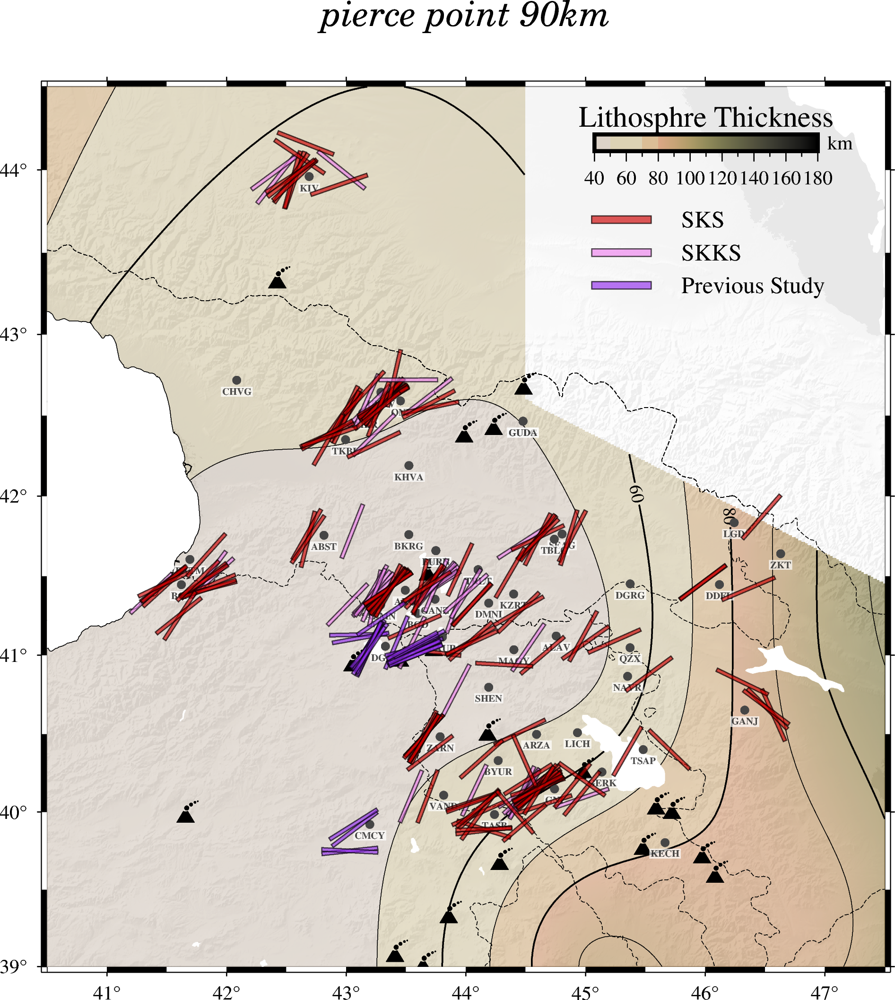

==================IU.GNI==================
GNI 20131123_074832
GNI 20200613_210830
GNI 20130514_003226
==================AM.ALAV==================
==================AM.ARZA==================
==================AM.BAUR==================
==================AM.BYUR==================
==================AM.GERK==================
==================AM.KECH==================
==================AM.LICH==================
==================AM.MAGY==================
==================AM.NAVR==================
==================AM.SHEN==================
==================AM.TSAP==================
==================AM.VAND==================
VAND 20200805_120536
VAND 20190731_150233
VAND 20160729_211826
VAND 20180211_231415
==================AM.ZARN==================
ZARN 20180211_231415
==================KO.BCA==================
==================KO.TASB==================
==================GO.AKH==================
==================GO.BGD==================
==================GO.CHVG==================
===

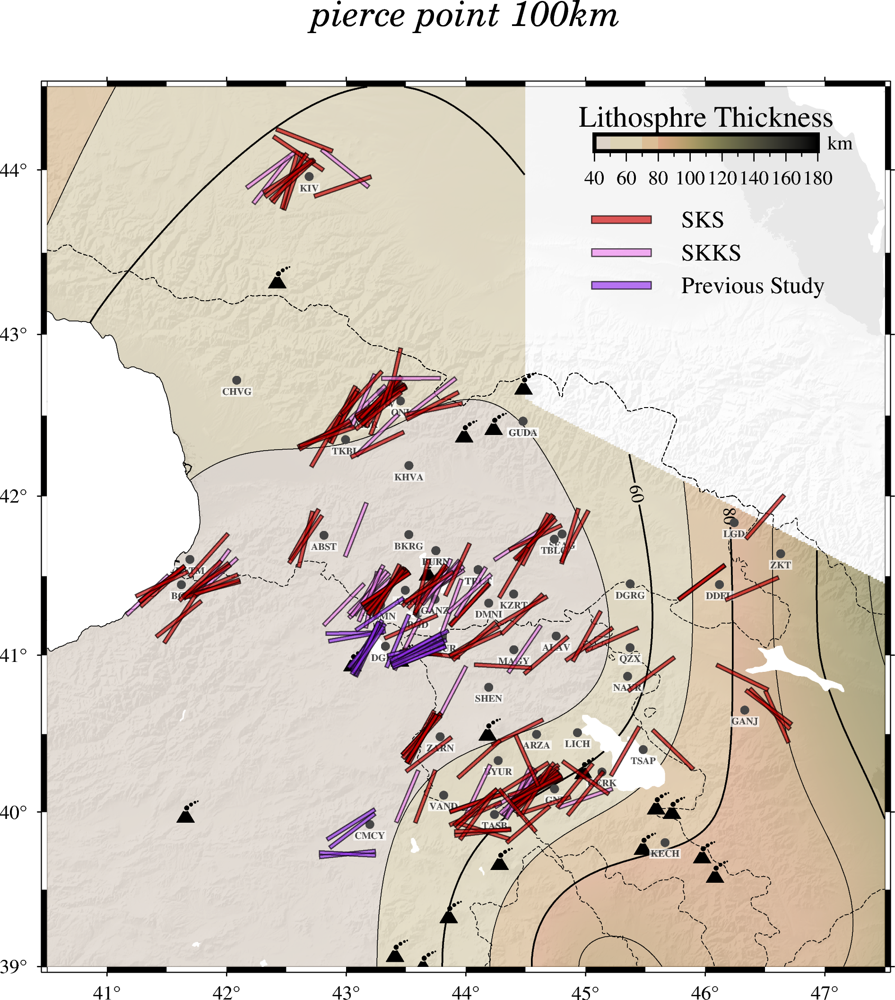

In [46]:
# region = [40, 47, 39.5, 44.5] original
# region = [42, 47, 38.5, 42] ## for AM
# region = [42, 47, 38, 41.5] ##for GNI
# region = [40.5, 47, 40.5, 43.5] ## for GO
# region = [41, 44, 43, 44.5] ## for KIV
region = [40.5, 47.5, 39, 44.5] ##for all
fig = 'All'

out = False 

ref='GNI'
refphi=49
std=15


for PierceDep in [50,60,70,80,90,100]:
    figmap = pygmt.Figure()
    title = f"pierce point {PierceDep}km"
    PygmtBegin(figmap,region,title)
    data = [[45.3, 43.7, 0, 5, 1*40]]
    figmap.plot(data=data, style="J", color='red3', pen="0.5p,black",transparency=35, no_clip=True)
    figmap.text(x=45.8,y=43.7, text='SKS', font="12p,4,black", justify='LM')
    data = [[45.3, 43.5, 0, 5, 1*40]]
    figmap.plot(data=data, style="J", color='violet', pen="0.5p,black",transparency=35, no_clip=True)
    figmap.text(x=45.8,y=43.5, text='SKKS', font="12p,4,black", justify='LM')
    data = [[45.3, 43.3, 0, 5, 1*40]]
    figmap.plot(data=data, style="J", color='purple2', pen="0.5p,black",transparency=35, no_clip=True)
    figmap.text(x=45.8,y=43.3, text='Previous Study', font="12p,4,black", justify='LM')
    for pkl in sorted(glob.glob(f'{PKLpath}/*.pkl')):
        STApkl = pickle.load(open(pkl, "rb"))
        values = [value for keys, value in STApkl.items() ][0]
        sta = values['station']
        stlat = values['latitude']; stlon = values['longitude']
        figmap.plot(x=stlon, y=stlat, style="c0.1c", color='70', pen="1.5p,70")
        figmap.text(x=stlon,y=stlat-0.07,text=sta, font="5p,Times-Bold,black",fill='white',transparency=30)
        
    for NET in ['IU','AM','KO','GO','TG','AB','XG','II']:    
        for pkl in sorted(glob.glob(f'{PKLpath}/{NET}*.pkl')):
            STApkl = pickle.load(open(pkl, "rb"))
            values = [value for keys, value in STApkl.items() ][0]
            net = values['network']; sta = values['station']
            stlat = values['latitude']; stlon = values['longitude']

#             figmap.plot(x=stlon, y=stlat, style="t0.1c", color='black', pen="1.5p,black")
            print(f'=================={net}.{sta}==================')

            for resultpath in sorted(glob.glob(f'{path}/2010-2020_*_classify/{net}.{sta}*result.csv')):
                df = pd.read_csv(resultpath)
                dff = df[df['Null']==False][df['Quality']!='Poor'][df['Pick']==True]
                dfff = df[df['Null']==True][df['Pick']==True]
                dff = dff.sort_values(by=['SCdt'], ascending=False)
                  
                for i in range(len(dff)):
                    event = dff['Event'].values[i]
                    evlat = dff['Ev_lat'].values[i]
                    evlon = dff['Ev_lon'].values[i]
                    evdep = dff['Depth'].values[i]
                    phase = dff['Phase'].values[i]
                    if sta in dr['station'].to_list() and event in dr['time'].to_list():
                            print(f'{sta} {event}')
                    else:
                        if method == 'SC': 
                            phi = dff['SCPhi'].values[i]
                            dt  = dff['SCdt'].values[i]
                            if phase == 'SKS': color = 'red3'
                            elif phase == 'SKKS': color = 'violet'
                            
                            if sta == 'CMCY' or sta == 'DGRL' :
                                color = 'purple2'
                        elif method == 'RC': 
                            phi = dff['RCPhi'].values[i]
                            dt  = dff['RCdt'].values[i]          
                            if phase == 'SKS': color = 'deepskyblue1'
                            elif phase == 'SKKS': color = 'skyblue'            
                        if out : 
                            if not (refphi-std) <phi<= (refphi+std) : 
                                p_lon, p_lat = PiercePoint(evdep, stlat, stlon, evlat, evlon, phase, PierceDep)
                                data = [[p_lon, p_lat, phi-90, 2.5, 1*40]]
                                figmap.plot(data=data, style="J", color=color, pen="0.5p,black",transparency=35, no_clip=True)
                        else: 
                            p_lon, p_lat = PiercePoint(evdep, stlat, stlon, evlat, evlon, phase, PierceDep)
                            data = [[p_lon, p_lat, phi-90, 2.5, 1*40]]
                            figmap.plot(data=data, style="J", color=color, pen="0.5p,black",transparency=35, no_clip=True)                            

    figmap.show()
    if out : 
        figmap.savefig(f'{figpath}/non-null/{fig}_{PierceDep}km_ref{ref}_std{std}.pdf')
        figmap.savefig(f'{figpath}/non-null/{fig}_{PierceDep}km_ref{ref}_std{std}.png', dpi=200)
    else:
        figmap.savefig(f'{figpath}/non-null/{fig}_{PierceDep}km_v3_lith.pdf')
        figmap.savefig(f'{figpath}/non-null/{fig}_{PierceDep}km_v3_lith.png', dpi=200)        
    
            

        

In [31]:
ST_Fault='/Volumes/home/Research/DataBase/01_Armenia/00_ST_Fault_with_Sard.txt'

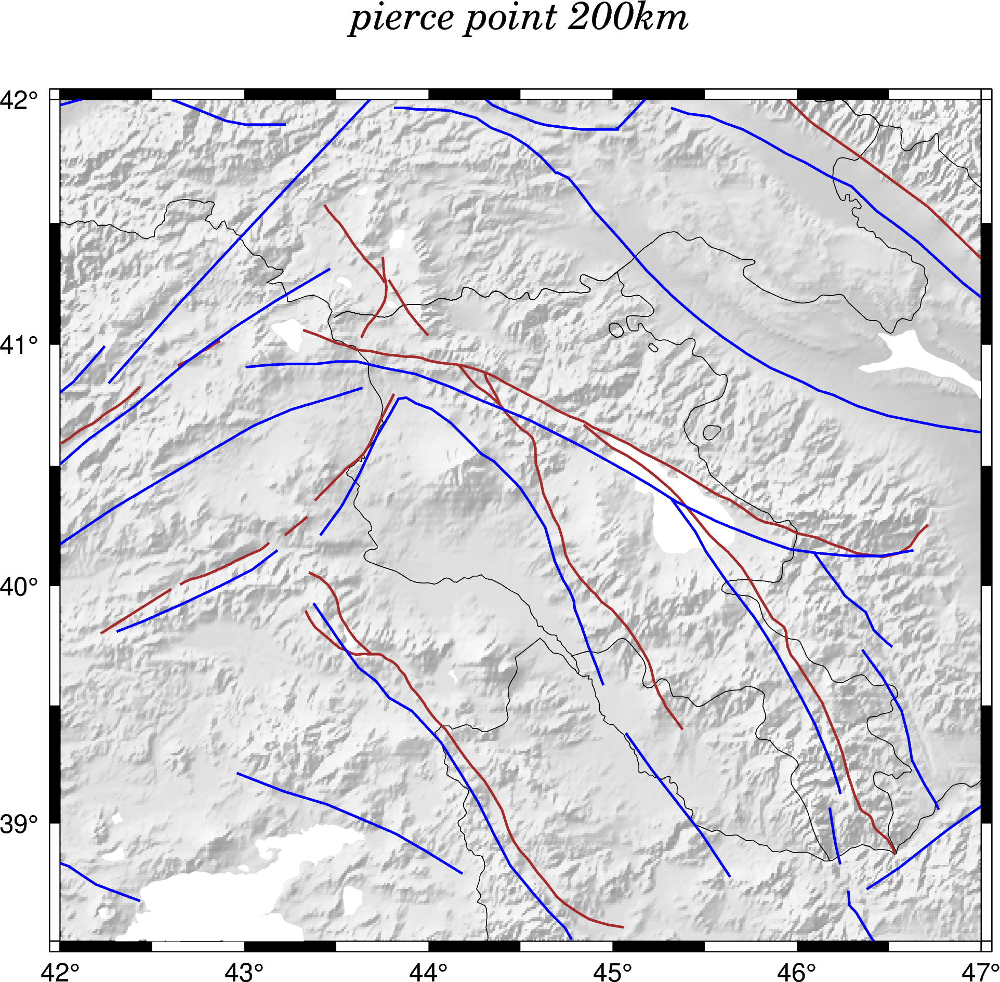

In [140]:
figmap = pygmt.Figure()
figmap.basemap(region=region, projection="M15c", frame = ['x1f0.5', 'y1f0.5', f'nSeW+t"{title}"'])
figmap.grdimage('@earth_relief_30s',region =region, cmap="eleva.cpt",monochrome=True, shading=True, transparency=50)
figmap.coast(resolution = 'h', shorelines ='1/thinnest,black', water='white', borders = '1/0.25p')


figmap.plot(data=smooth_fault,pen='1p,brown')
figmap.plot(data=Afault,pen='1p,blue')
figmap.show()

### Specific for one station

==================GO.AKH==================
==================TG.AZMN==================
==================GO.BGD==================
==================TG.GANZ==================
==================TG.DMNI==================
==================TG.TRLT==================
==================XG.DGRL==================


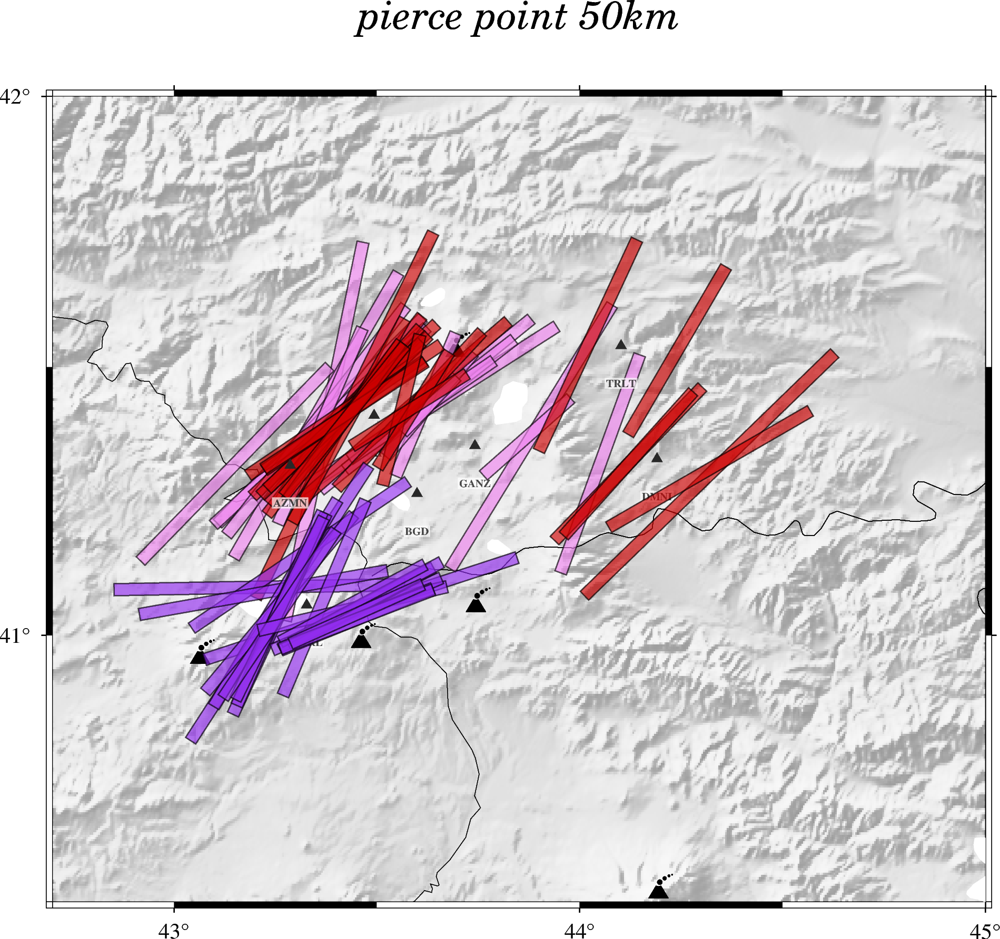

==================GO.AKH==================
==================TG.AZMN==================
==================GO.BGD==================
==================TG.GANZ==================
==================TG.DMNI==================
==================TG.TRLT==================
==================XG.DGRL==================


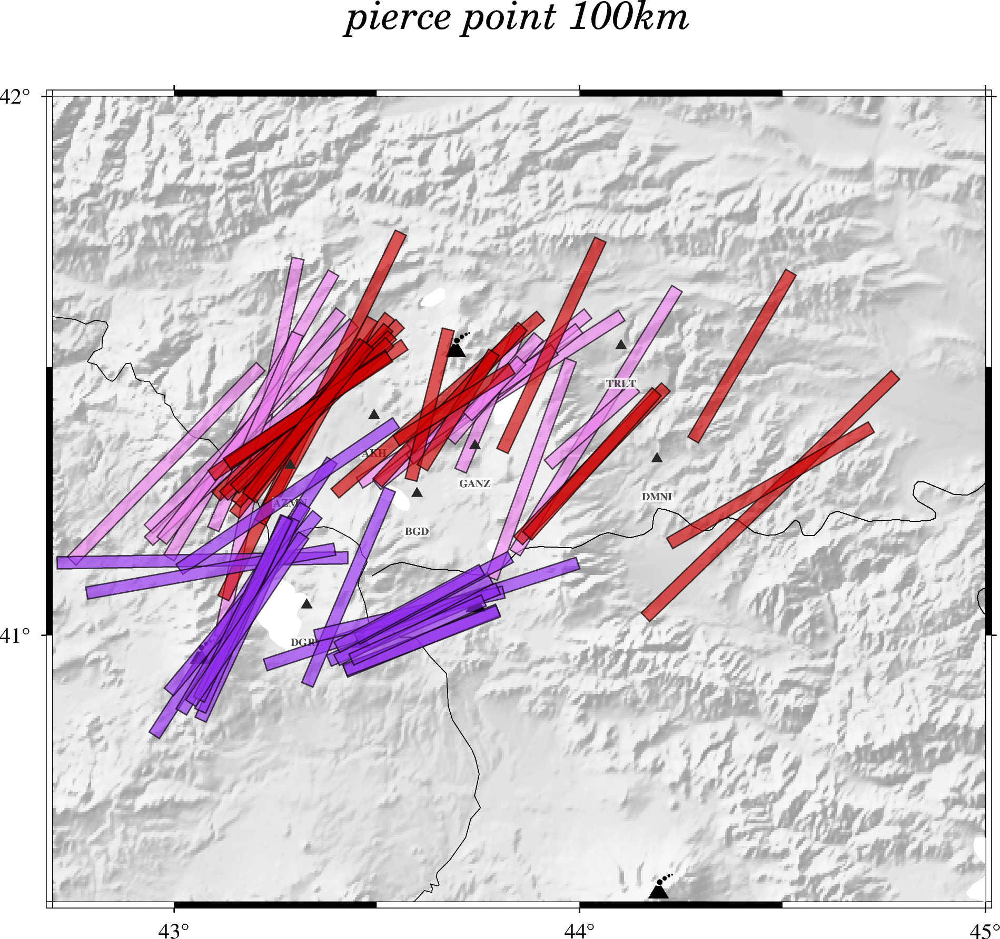

==================GO.AKH==================
==================TG.AZMN==================
==================GO.BGD==================
==================TG.GANZ==================
==================TG.DMNI==================
==================TG.TRLT==================
==================XG.DGRL==================


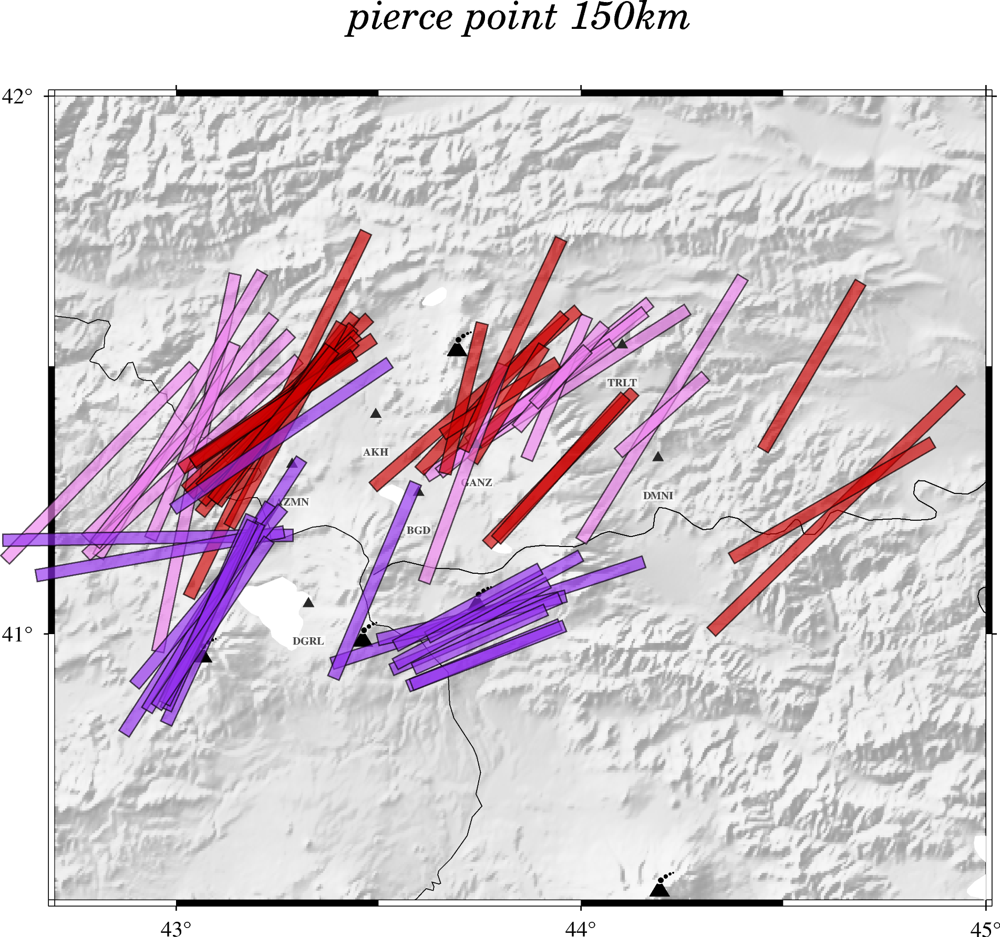

==================GO.AKH==================
==================TG.AZMN==================
==================GO.BGD==================
==================TG.GANZ==================
==================TG.DMNI==================
==================TG.TRLT==================
==================XG.DGRL==================


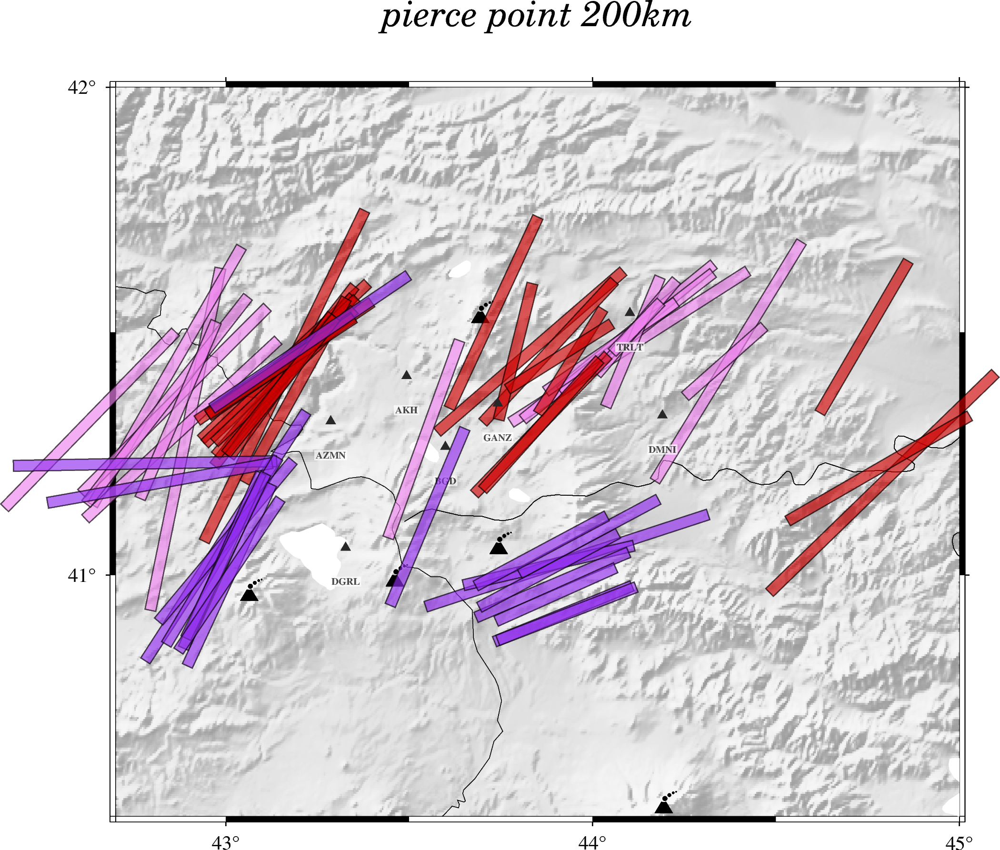

In [9]:
# region = [40, 47, 39.5, 44.5] original
# region = [42, 47, 38.5, 42] ## for AM

# region = [40.5, 47, 40.5, 43.5] ## for GO
# region = [41, 44, 43, 44.5] ## for KIV
# region = [40.5, 47.5, 39, 44.5] ##for all
fig = 'AKH'

if fig == 'GNI':
    Stalist = ['GNI', 'VAND','TASB','GERK','BYUR','ARZA','CMCY']
    region = [42.5, 46, 39, 41] ##for GNI
elif fig == 'AKH':
    Stalist = ['AKH', 'AZMN','BGD','GANZ','DMNI','TRLT','DGRL']
    region = [42.7, 45, 40.5, 42] ## for AKH


for PierceDep in [50,100,150,200]:
    figmap = pygmt.Figure()
    title = f"pierce point {PierceDep}km"
    PygmtBegin(figmap,region,title)
    for station in Stalist: 
        for pkl in sorted(glob.glob(f'{PKLpath}/*{station}.pkl')):
            STApkl = pickle.load(open(pkl, "rb"))
            values = [value for keys, value in STApkl.items() ][0]
            sta = values['station']
            stlat = values['latitude']; stlon = values['longitude']
            figmap.plot(x=stlon, y=stlat, style="t0.1c", color='70', pen="1.5p,40")
            figmap.text(x=stlon,y=stlat-0.07,text=sta, font="5p,Times-Bold,black",fill='white',transparency=30)

       
        for pkl in sorted(glob.glob(f'{PKLpath}/*{station}.pkl')):
            STApkl = pickle.load(open(pkl, "rb"))
            values = [value for keys, value in STApkl.items() ][0]
            net = values['network']; sta = values['station']
            stlat = values['latitude']; stlon = values['longitude']

#             figmap.plot(x=stlon, y=stlat, style="t0.1c", color='black', pen="1.5p,black")
            print(f'=================={net}.{sta}==================')

            for resultpath in sorted(glob.glob(f'{path}/2010-2020_*_classify/{net}.{sta}*result.csv')):
                df = pd.read_csv(resultpath)
                dff = df[df['Null']==False][df['Quality']!='Poor'][df['Pick']==True]
                dfff = df[df['Null']==True][df['Pick']==True]
                dff = dff.sort_values(by=['SCdt'], ascending=False)
                  
                for i in range(len(dff)):
                    event = dff['Event'].values[i]
                    evlat = dff['Ev_lat'].values[i]
                    evlon = dff['Ev_lon'].values[i]
                    evdep = dff['Depth'].values[i]
                    phase = dff['Phase'].values[i]
                    if sta in dr['station'].to_list() and event in dr['time'].to_list():
                            print(f'{sta} {event}')
                    else:
                        if method == 'SC': 
                            phi = dff['SCPhi'].values[i]
                            dt  = dff['SCdt'].values[i]
                            if phase == 'SKS': color = 'red3'
                            elif phase == 'SKKS': color = 'violet'
                            
                            if sta == 'CMCY' or sta == 'DGRL' :
                                color = 'purple2'
                        elif method == 'RC': 
                            phi = dff['RCPhi'].values[i]
                            dt  = dff['RCdt'].values[i]          
                            if phase == 'SKS': color = 'deepskyblue1'
                            elif phase == 'SKKS': color = 'skyblue'            
                        p_lon, p_lat = PiercePoint(evdep, stlat, stlon, evlat, evlon, phase, PierceDep)
                        data = [[p_lon, p_lat, phi-90, 2.5, dt*40]]
                        figmap.plot(data=data, style="J", color=color, pen="0.5p,black",transparency=35, no_clip=True)                            

                

    figmap.show()
    figmap.savefig(f'{figpath}/non-null/{fig}_{PierceDep}km.pdf')
    figmap.savefig(f'{figpath}/non-null/{fig}_{PierceDep}km.png',dpi=200)

            

        

In [11]:
for resultpath in sorted(glob.glob(f'{path}/2010-2020_*_classify/*GNI*result.csv')):
    df = pd.read_csv(resultpath)
    dff = df[df['Null']==False][df['Quality']!='Poor'][df['Pick']==True]
    dfff = df[df['Null']==True][df['Pick']==True]
    dff = dff.sort_values(by=['SCdt'], ascending=False)

    for i in range(len(dff)):
        event = dff['Event'].values[i]
        evlat = dff['Ev_lat'].values[i]
        evlon = dff['Ev_lon'].values[i]
        evdep = dff['Depth'].values[i]
        phase = dff['Phase'].values[i]
        phi = dff['SCPhi'].values[i]
        if 'GNI' in dr['station'].to_list() and event in dr['time'].to_list():
                print(f'==========GNI {event} remove: {phi}')
        else:
            print(f'GNI {event} {phi} {phase}')
        
        

==========GNI 20131123_074832 remove: -81.85
GNI 20160725_172650 35.84 SKKS
GNI 20200603_073534 34.43 SKKS
GNI 20120703_103615 70.94 SKKS
GNI 20180410_101934 48.16 SKKS
GNI 20150610_135208 57.31 SKKS
GNI 20150211_185720 25.59 SKKS
GNI 20190120_013251 32.11 SKKS
GNI 20190301_085042 72.58 SKS
GNI 20180907_021204 51.49 SKS
GNI 20110824_174611 41.85 SKS
==========GNI 20200613_210830 remove: -45.14
GNI 20120802_093831 54.95 SKS
GNI 20181211_022632 72.04 SKS
GNI 20200603_073534 63.0 SKS
==========GNI 20130514_003226 remove: -67.13
GNI 20160804_141513 54.93 SKS
GNI 20170415_081943 50.06 SKS
GNI 20180121_010642 64.33 SKS
GNI 20200531_050938 57.0 SKS
GNI 20160804_141513 45.93 SKS
GNI 20150610_135208 51.0 SKS
GNI 20141206_220510 39.23 SKS
GNI 20190503_072529 39.35 SKS
GNI 20140218_092714 58.0 SKS
GNI 20180828_223513 -54.63 SKS
GNI 20150211_185720 32.0 SKS
GNI 20110306_123158 62.0 SKS
